# Action Potentials on a cable structure
In this notebook we are going to simulate the spread of an action potential using a cable model
<div style="width:50%">![title](https://upload.wikimedia.org/wikipedia/commons/thumb/0/0c/Cable_theory_Neuron_RC_circuit_v3.svg/1200px-Cable_theory_Neuron_RC_circuit_v3.svg.png)</div>

In [1]:
from tqdm import tqdm_notebook
import numpy as np
import matplotlib.pyplot as plt

# for animation
from matplotlib import animation, rc
from IPython.display import HTML

%matplotlib inline

## Constants

In [2]:
V_rest = -65 # resting membrane voltage (mV)

# Nernst voltages
E_K = V_rest - 12 # potassium Nernst voltage (mV)
E_Na = V_rest + 115 # sodium Nernst voltage (mV)
E_L = V_rest + 10.6 # leak Nernst voltage (mV)

C_m = 1# membrane capacitance (uF/cm^2)

# ion conductivities
G_Na_max = 120 # max sodium conductance (mS/cm^2)
G_K_max = 36 # max potassium conductance (mS/cm^2)

# leakage conductivity
G_L = 0.3 # leakage conductance (mS/cm^2)

d = 0.00020 # diameter of zylindric fiber (cm)

In [3]:
def calc_gates(V_m):
    if V_m == -55:
        alpha_n = 1
    else:
        alpha_n =0.01 * (-(V_m + 55)/(np.exp(-(V_m + 55)/10)-1))
    beta_n = 0.125 * np.exp(-(V_m + 65)/80)
    
    if V_m == -40:
        alpha_m = 1
    else:
        alpha_m = 0.1 * (- (V_m + 40) / (np.exp(-(V_m + 40)/10)-1))
    beta_m = 4 * np.exp(-(V_m + 65)/18)
    alpha_h = 0.07 * np.exp(-(V_m + 65)/20)
    beta_h = 1/(np.exp(-(V_m + 35)/10)+1)
    return alpha_n, beta_n, alpha_m, beta_m, alpha_h, beta_h

## Simulation Properties

In [30]:
delta_t = 0.02
t_end = 50
timesteps = np.arange(0,t_end, delta_t)
n_timesteps = len(timesteps)

delta_x = 0.1 # cm
x_min = 0 # cm
x_max = 7 # cm
positions = np.arange(x_min, x_max, delta_x)
n_positions = len(positions)

v = 12.7
ddtOdx2 = 1 / v

# initial values
n0 = 0.317711
m0 = 0.0529347
h0 = 0.596385
V0 = V_rest

I_stim = 25 # stimulus amplitude (uA/cm^2)
t_stim = 3 # stimulus duration (ms)
x_stim = 7 # stimulus position (cm)
x_stim_index = (x_stim - x_min) // delta_x

## Simulation

In [31]:
# variables
alpha_n = np.zeros((n_positions, n_timesteps))
beta_n = np.zeros((n_positions, n_timesteps))
alpha_m = np.zeros((n_positions, n_timesteps))
beta_m = np.zeros((n_positions, n_timesteps))
alpha_h = np.zeros((n_positions, n_timesteps))
beta_h = np.zeros((n_positions, n_timesteps))

n = np.zeros((n_positions, n_timesteps))
n_dot = np.zeros((n_positions, n_timesteps))
m = np.zeros((n_positions, n_timesteps))
m_dot = np.zeros((n_positions, n_timesteps))
h = np.zeros((n_positions, n_timesteps))
h_dot = np.zeros((n_positions, n_timesteps))

I_K = np.zeros((n_positions, n_timesteps))
I_Na = np.zeros((n_positions, n_timesteps))
I_L = np.zeros((n_positions, n_timesteps))

V_m = np.zeros((n_positions, n_timesteps))
V_m_dot = np.zeros((n_positions, n_timesteps))

# initialize
V_m[:, 0] = V0
n[:, 0] = n0
m[:, 0] = m0
h[:, 0] = h0

# iterate
for t_index,t in enumerate(tqdm_notebook(timesteps)):   
    
    for x_index, x in enumerate(positions):
        # calculate ion gates
        alpha_n[x_index, t_index], beta_n[x_index, t_index], alpha_m[x_index, t_index], beta_m[x_index, t_index], alpha_h[x_index, t_index], beta_h[x_index, t_index] = calc_gates(V_m[x_index, t_index])

        n_dot[x_index, t_index] = alpha_n[x_index, t_index] * (1 - n[x_index, t_index]) - beta_n[x_index, t_index] * n[x_index, t_index]
        m_dot[x_index, t_index] = alpha_m[x_index, t_index] * (1 - m[x_index, t_index]) - beta_m[x_index, t_index] * m[x_index, t_index]
        h_dot[x_index, t_index] = alpha_h[x_index, t_index] * (1 - h[x_index, t_index]) - beta_h[x_index, t_index] * h[x_index, t_index]

        if t_index < n_timesteps-1:
            n[x_index, t_index+1] = n[x_index, t_index] + n_dot[x_index, t_index] * delta_t
            m[x_index, t_index+1] = m[x_index, t_index] + m_dot[x_index, t_index] * delta_t
            h[x_index, t_index+1] = h[x_index, t_index] + h_dot[x_index, t_index] * delta_t

        # calculate ion currents
        I_K[x_index, t_index] = (V_m[x_index, t_index]-E_K) * G_K_max * n[x_index, t_index]**4
        I_Na[x_index, t_index] = (V_m[x_index, t_index]-E_Na) * G_Na_max * m[x_index, t_index]**3 * h[x_index, t_index]
        I_L[x_index, t_index] = (V_m[x_index, t_index]-E_L) * G_L

        # calcultate membrane voltage change
        V_m_dot[x_index, t_index] = - 1/C_m * (I_K[x_index, t_index] + I_Na[x_index, t_index] + I_L[x_index, t_index])

        if t < t_stim and (x_index == 0 or x_index == x_stim_index):
            V_m_dot[x_index, t_index] += I_stim

        # calcultate membrane voltage
        if t_index < n_timesteps-1:
            if x_index == 0:
                xlap = 2 * V_m[x_index+1, t_index]
            elif x_index == n_positions - 1:
                xlap = 2 * V_m[x_index-1, t_index]
            else:
                xlap = V_m[x_index+1, t_index] + V_m[x_index-1, t_index]
            
            V_m[x_index, t_index+1] = V_m[x_index, t_index] + delta_t * V_m_dot[x_index, t_index] 
            if xlap > 2 * V_m[x_index, t_index]: # only along diffusion gradient
                V_m[x_index, t_index+1] += ddtOdx2 * (xlap - 2 * V_m[x_index, t_index])

## Plot Results

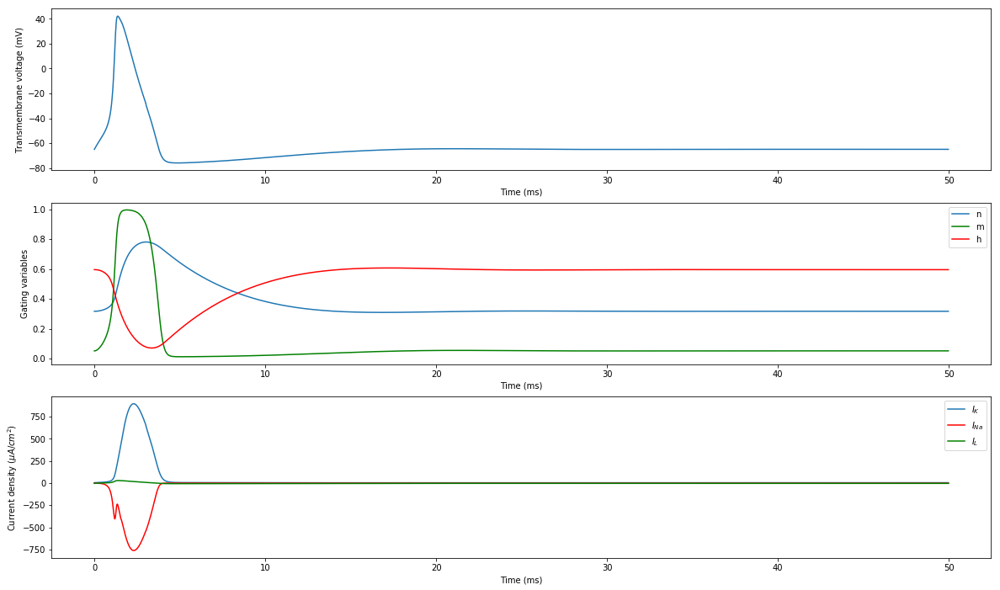

In [28]:
plt.figure(figsize=(20, 12))
plt.subplot(3,1,1)
plt.plot(timesteps,V_m[0,:])
plt.xlabel('Time (ms)')
plt.ylabel('Transmembrane voltage (mV)')

plt.subplot(3,1,2)
plt.plot(timesteps,n[0,:])
plt.plot(timesteps, m[0,:], 'g')
plt.plot(timesteps,h[0,:],'r')
plt.legend(['n','m','h'])
plt.xlabel('Time (ms)')
plt.ylabel('Gating variables')

plt.subplot(3,1,3)
plt.plot(timesteps,I_K[0,:])
plt.plot(timesteps, I_Na[0,:],'r')
plt.plot(timesteps,I_L[0,:],'g')
plt.legend(['$I_K$','$I_{Na}$','$I_L$'])
plt.xlabel('Time (ms)')
plt.ylabel('Current density ($\mu A/cm^2$)')
plt.show()

## Animate

Animation size has reached 20982148 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


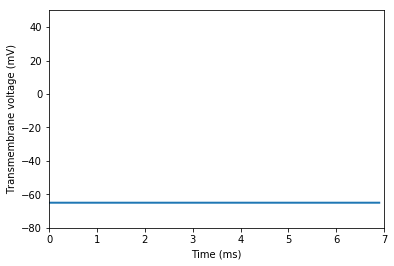

In [32]:
# setup canvas
fig, ax = plt.subplots()

ax.set_xlim(( x_min, x_max))
ax.set_ylim((-80, 50))
plt.xlabel('Time (ms)')
plt.ylabel('Transmembrane voltage (mV)')

line, = ax.plot([], [], lw=2)

# create animation
def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    line.set_data(positions, V_m[:,int(i // delta_t)])
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=timesteps, interval=delta_t * 1000, 
                               blit=True)
# embed as html video
#HTML(anim.to_html5_video()) 
# interactive player
HTML(anim.to_jshtml())